## **CycleGAN try 1**

* pre-trained 모델을 끌고 와서 쓰는 것이 아닌 하나하나 쌓아가는 방식으로 해봤습니다.

* 풍경 사진을 터너(영국의 화가)의 그림체로 바꾸고, 반대로 터너의 그림을 풍경 사진처럼 바꾸는 task를 수행하는 모델입니다.

* 결과물이 영 좋지 않습니다..

**데이터셋 설명**

아래 데이터셋은 활용도가 좋을 것 같아 코랩 계정 드라이브에도 올려두겠습니다!  

1. Kaggle dataset: Collections of Paintings from 50 Artists  
(터너 말고도 다른 화가들의 작품이 많아 활용성이 좋을 것 같습니다)  
https://www.kaggle.com/code/paultimothymooney/collections-of-paintings-from-50-artists/input


2. Kaggle dataset: Landscape Pictures  
https://www.kaggle.com/datasets/arnaud58/landscape-pictures

In [ ]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torch.autograd import Variable
import torch.utils.data as data
import random
from torchvision import transforms
import torchvision.models.vgg as vgg
import torch.utils.model_zoo as model_zoo
from collections import namedtuple
import torch
from PIL import Image

import torch.nn.functional as F

import os, itertools
# print(os.listdir("../input/buildings"))
import copy

import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#model params
params = {
    'batch_size':1,
    'input_size':256,
    'resize_scale':286,
    'crop_size':256,
    'fliplr':True,
    'num_epochs':20,
    'decay_epoch':20,
    'ngf':32,   #number of generator filters
    'ndf':64,   #number of discriminator filters
    'num_resnet':6, #number of resnet blocks
    'lrG':0.0002,    #learning rate for generator
    'lrD':0.0002,    #learning rate for discriminator
    'beta1':0.5 ,    #beta1 for Adam optimizer
    'beta2':0.999 ,  #beta2 for Adam optimizer
    'lambdaA':10 ,   #lambdaA for cycle loss
    'lambdaB':10  ,  #lambdaB for cycle loss
}

In [ ]:
!unzip -qq "img.zip"
!ls

drive  img  img.zip  sample_data


In [ ]:
data_dir = '/content/img'

In [ ]:
def to_np(x):
    return x.data.cpu().numpy()
def plot_train_result(real_image, gen_image, recon_image, epoch, save=False,  show=True, fig_size=(15, 15)):
    fig, axes = plt.subplots(2, 3, figsize=fig_size)
    imgs = [to_np(real_image[0]), to_np(gen_image[0]), to_np(recon_image[0]),
            to_np(real_image[1]), to_np(gen_image[1]), to_np(recon_image[1])]
    for ax, img in zip(axes.flatten(), imgs):
        ax.axis('off')
        #ax.set_adjustable('box-forced')
        # Scale to 0-255
        img = img.squeeze()
        img = (((img - img.min()) * 255) / (img.max() - img.min())).transpose(1, 2, 0).astype(np.uint8)
        ax.imshow(img, cmap=None, aspect='equal')
    plt.subplots_adjust(wspace=0, hspace=0)

    title = 'Epoch {0}'.format(epoch + 1)
    fig.text(0.5, 0.04, title, ha='center')

    # save figure
    if save:
        save_fn = 'Result_epoch_{:d}'.format(epoch+1) + '.png'
        plt.savefig(save_fn)

    if show:
        plt.show()
    else:
        plt.close()

In [ ]:
class ImagePool():
    def __init__(self, pool_size):
        self.pool_size = pool_size
        if self.pool_size > 0:
            self.num_imgs = 0
            self.images = []

    def query(self, images):
        if self.pool_size == 0:
            return images
        return_images = []
        for image in images.data:
            image = torch.unsqueeze(image, 0)
            if self.num_imgs < self.pool_size:
                self.num_imgs = self.num_imgs + 1
                self.images.append(image)
                return_images.append(image)
            else:
                p = random.uniform(0, 1)
                if p > 0.5:
                    random_id = random.randint(0, self.pool_size-1)
                    tmp = self.images[random_id].clone()
                    self.images[random_id] = image
                    return_images.append(tmp)
                else:
                    return_images.append(image)
        return_images = Variable(torch.cat(return_images, 0))
        return return_images
        
class DatasetFromFolder(data.Dataset):
    def __init__(self, image_dir, subfolder='train', transform=None, resize_scale=None, crop_size=None, fliplr=False):
        super(DatasetFromFolder, self).__init__()
        self.input_path = os.path.join(image_dir, subfolder)
        self.image_filenames = [x for x in sorted(os.listdir(self.input_path))]
        self.transform = transform
        
        self.resize_scale = resize_scale
        self.crop_size = crop_size
        self.fliplr = fliplr

    def __getitem__(self, index):
        # Load Image
        img_fn = os.path.join(self.input_path, self.image_filenames[index])
        img = Image.open(img_fn).convert('RGB')

        # preprocessing
        if self.resize_scale:
            img = img.resize((self.resize_scale, self.resize_scale), Image.BILINEAR)

        if self.crop_size:
            x = random.randint(0, self.resize_scale - self.crop_size + 1)
            y = random.randint(0, self.resize_scale - self.crop_size + 1)
            img = img.crop((x, y, x + self.crop_size, y + self.crop_size))
        if self.fliplr:
            if random.random() < 0.5:
                img = img.transpose(Image.FLIP_LEFT_RIGHT)

        if self.transform is not None:
            img = self.transform(img)

        return img

    def __len__(self):
        return len(self.image_filenames)

# CycleGAN Architecture<br>

In [ ]:
#https://github.com/aitorzip/PyTorch-CycleGAN/blob/master/models.py
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        conv_block = [  nn.ReflectionPad2d(1),
                        nn.Conv2d(in_features, in_features, 3),
                        nn.InstanceNorm2d(in_features),
                        nn.ReLU(inplace=True),
                        nn.ReflectionPad2d(1),
                        nn.Conv2d(in_features, in_features, 3),
                        nn.InstanceNorm2d(in_features)  ]

        self.conv_block = nn.Sequential(*conv_block)

    def forward(self, x):
        return x + self.conv_block(x)

class Generator(nn.Module):
    def __init__(self, input_nc, output_nc, n_residual_blocks=9):
        super(Generator, self).__init__()

        # Initial convolution block       
        model = [   nn.ReflectionPad2d(3),
                    nn.Conv2d(input_nc, 64, 7),
                    nn.InstanceNorm2d(64),
                    nn.ReLU(inplace=True) ]

        # Downsampling
        in_features = 64
        out_features = in_features*2
        for _ in range(2):
            model += [  nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                        nn.InstanceNorm2d(out_features),
                        nn.ReLU(inplace=True) ]
            in_features = out_features
            out_features = in_features*2

        # Residual blocks
        for _ in range(n_residual_blocks):
            model += [ResidualBlock(in_features)]

        # Upsampling
        out_features = in_features//2
        for _ in range(2):
            model += [  nn.ConvTranspose2d(in_features, out_features, 3, stride=2, padding=1, output_padding=1),
                        nn.InstanceNorm2d(out_features),
                        nn.ReLU(inplace=True) ]
            in_features = out_features
            out_features = in_features//2

        # Output layer
        model += [  nn.ReflectionPad2d(3),
                    nn.Conv2d(64, output_nc, 7),
                    nn.Tanh() ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

class Discriminator(nn.Module):
    def __init__(self, input_nc):
        super(Discriminator, self).__init__()

        # A bunch of convolutions one after another
        model = [   nn.Conv2d(input_nc, 64, 4, stride=2, padding=1),
                    nn.LeakyReLU(0.2, inplace=True) ]

        model += [  nn.Conv2d(64, 128, 4, stride=2, padding=1),
                    nn.InstanceNorm2d(128), 
                    nn.LeakyReLU(0.2, inplace=True) ]

        model += [  nn.Conv2d(128, 256, 4, stride=2, padding=1),
                    nn.InstanceNorm2d(256), 
                    nn.LeakyReLU(0.2, inplace=True) ]

        model += [  nn.Conv2d(256, 512, 4, padding=1),
                    nn.InstanceNorm2d(512), 
                    nn.LeakyReLU(0.2, inplace=True) ]

        # FCN classification layer
        model += [nn.Conv2d(512, 1, 4, padding=1)]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        x =  self.model(x)
        # Average pooling and flatten
        return F.avg_pool2d(x, x.size()[2:]).view(x.size()[0], -1)

# LOAD THE DATASET

In [ ]:
transform = transforms.Compose([
    transforms.Resize(size=params['input_size']),
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
])
#Subfolders - day & night
train_data_A = DatasetFromFolder(data_dir, subfolder='landscape', transform=transform,
                                resize_scale=params['resize_scale'], crop_size=params['crop_size'], fliplr=params['fliplr'])
train_data_loader_A = torch.utils.data.DataLoader(dataset=train_data_A, batch_size=params['batch_size'], shuffle=True)
train_data_B = DatasetFromFolder(data_dir, subfolder='turner', transform=transform,
                                resize_scale=params['resize_scale'], crop_size=params['crop_size'], fliplr=params['fliplr'])
train_data_loader_B = torch.utils.data.DataLoader(dataset=train_data_B, batch_size=params['batch_size'], shuffle=True)

#Kaggle GPU
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
#After each epoch output of these input images (tensors) will be displayed
test_real_A_data = train_data_A.__getitem__(60).unsqueeze(0) 
test_real_B_data = train_data_B.__getitem__(65).unsqueeze(0)

In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm2d') != -1:
        torch.nn.init.normal(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant(m.bias.data, 0.0)

# Build the Model 
Trained the model with and without using the discriminator D_B to check the performance.

In [ ]:
#Build Model 
#G_A - landscape -> turner ; G_B - turner -> landscape
G_A = Generator(3,3).cuda() 
G_B = Generator(3,3).cuda()

#two Discriminators
D_A = Discriminator(3).cuda()
D_B = Discriminator(3).cuda()

G_A.apply(weights_init_normal)
G_B.apply(weights_init_normal)
D_A.apply(weights_init_normal)
D_B.apply(weights_init_normal)


G_optimizer = torch.optim.Adam(itertools.chain(G_A.parameters(), G_B.parameters()), lr=params['lrG'], betas=(params['beta1'], params['beta2']))
D_A_optimizer = torch.optim.Adam(D_A.parameters(), lr=params['lrD'], betas=(params['beta1'], params['beta2']))
D_B_optimizer = torch.optim.Adam(D_B.parameters(), lr=params['lrD'], betas=(params['beta1'], params['beta2']))

<ipython-input-12-75d0f6e307d4>:4: UserWarning: nn.init.normal is now deprecated in favor of nn.init.normal_.
  torch.nn.init.normal(m.weight.data, 0.0, 0.02)


# Loss functions<br>
One of the things different from the model proposed by the base paper is the usage of VGG16 network for computing generator identity losses. Its usage gave more sharp and vibrant output images. This method was used to compute style loss in this [article](https://pytorch.org/tutorials/advanced/neural_style_tutorial.html) and I adapted the method to compute Identity loss, instead of MAE used in the base paper implementation. <br>
During the training process, for the Generator mainly three losses are computed namely Adverarial loss, Cycle loss and Identity loss, and for the Discriminator  

In [ ]:
MSE_Loss = torch.nn.MSELoss().cuda()
L1_Loss = torch.nn.L1Loss().cuda()
LossOutput = namedtuple("LossOutput", ["relu1_2", "relu2_2", "relu3_3", "relu4_3"])

# https://discuss.pytorch.org/t/how-to-extract-features-of-an-image-from-a-trained-model/119/3
class LossNetwork(torch.nn.Module):
    def __init__(self, vgg_model):
        super(LossNetwork, self).__init__()
        self.vgg_layers = vgg_model.features
        self.layer_name_mapping = {
            '3': "relu1_2",
            '8': "relu2_2",
            '15': "relu3_3",
            '22': "relu4_3"
        }
    
    def forward(self, x):
        output = {}
        for name, module in self.vgg_layers._modules.items():
            x = module(x)
            if name in self.layer_name_mapping:
                output[self.layer_name_mapping[name]] = x
        return LossOutput(**output)

vgg_model = vgg.vgg16(pretrained=True)
if torch.cuda.is_available():
    vgg_model.cuda()
loss_network = LossNetwork(vgg_model)
loss_network.eval()
del vgg_model

def gram_matrix(y):
    (b, ch, h, w) = y.size()
    features = y.view(b, ch, w * h)
    features_t = features.transpose(1, 2)
    gram = features.bmm(features_t) / (ch * h * w)
    return gram

def compStyle(a,b):
    #http://pytorch.org/docs/master/notes/autograd.html#volatile
    styleB_loss_features = loss_network(Variable(a, volatile=True))
    gram_style = [Variable(gram_matrix(y).data, requires_grad=False) for y in styleB_loss_features]
        
    features_y = loss_network(b)
        
    style_loss = 0    
    for m in range(len(features_y)):
        gram_s = gram_style[m]
        gram_y = gram_matrix(features_y[m])
        style_loss += 1e4 * MSE_Loss(gram_y, gram_s.expand_as(gram_y))
    return style_loss

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

# Train Model

<ipython-input-14-ea944eb2f45e>:41: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  styleB_loss_features = loss_network(Variable(a, volatile=True))


Epoch [1/20], Step [1/61], D_A_loss: 0.0616, D_B_loss: 0.1251, G_A_loss: 1.5238, G_B_loss: 0.4513


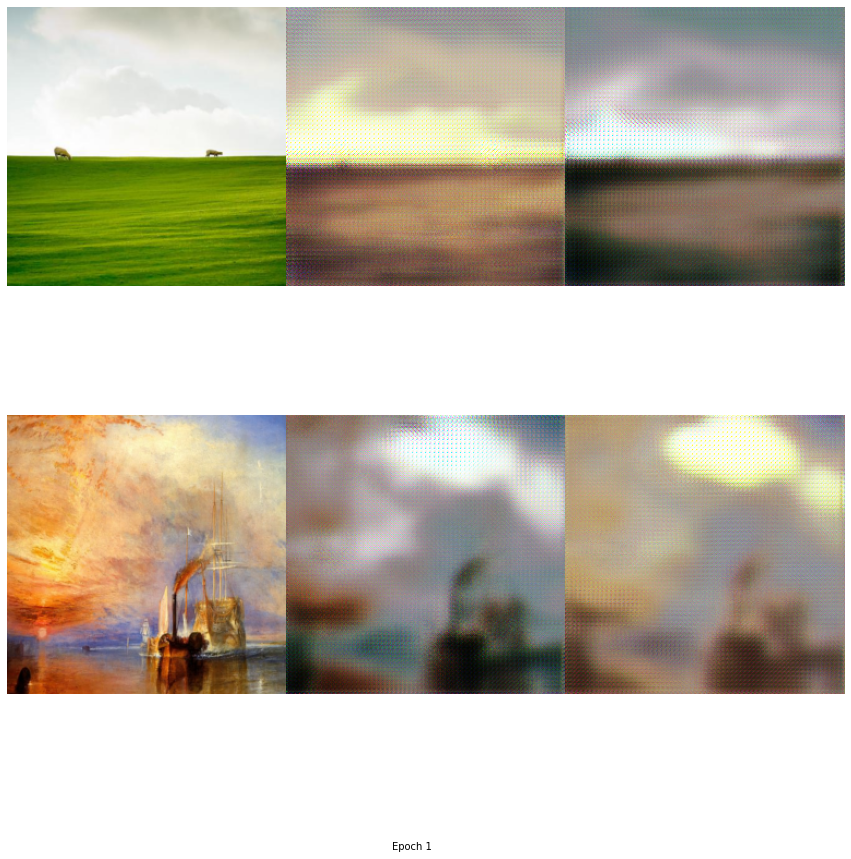

Epoch [2/20], Step [1/61], D_A_loss: 0.1273, D_B_loss: 0.0115, G_A_loss: 0.7224, G_B_loss: 0.6400


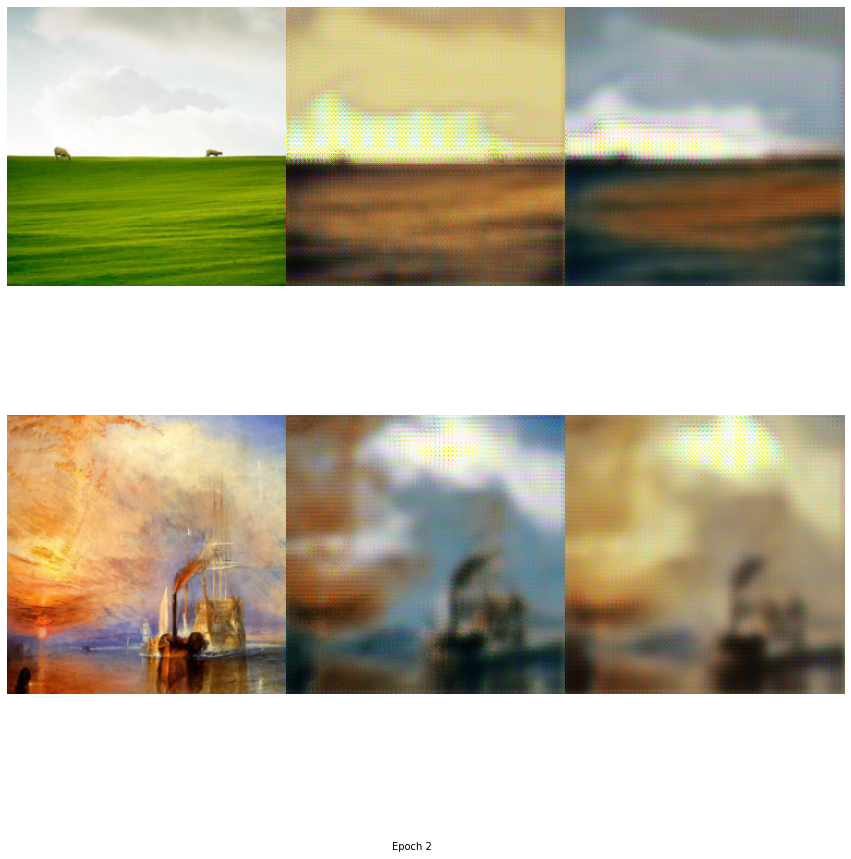

Epoch [3/20], Step [1/61], D_A_loss: 0.4203, D_B_loss: 0.1033, G_A_loss: 0.3250, G_B_loss: 0.0338


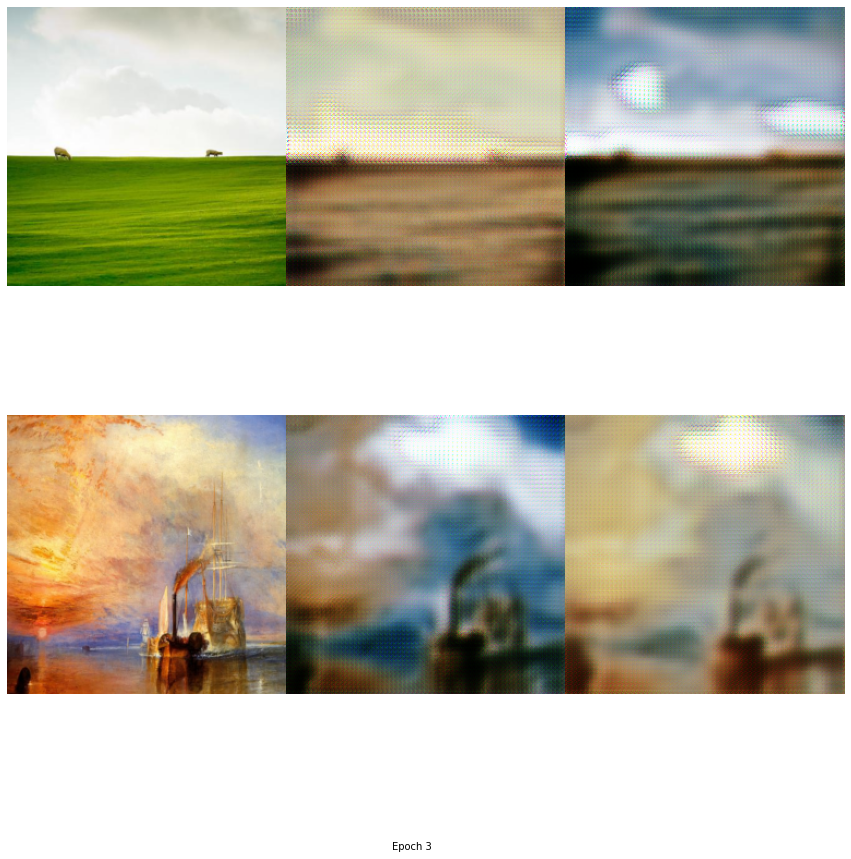

Epoch [4/20], Step [1/61], D_A_loss: 0.0566, D_B_loss: 0.2531, G_A_loss: 0.1045, G_B_loss: 0.5002


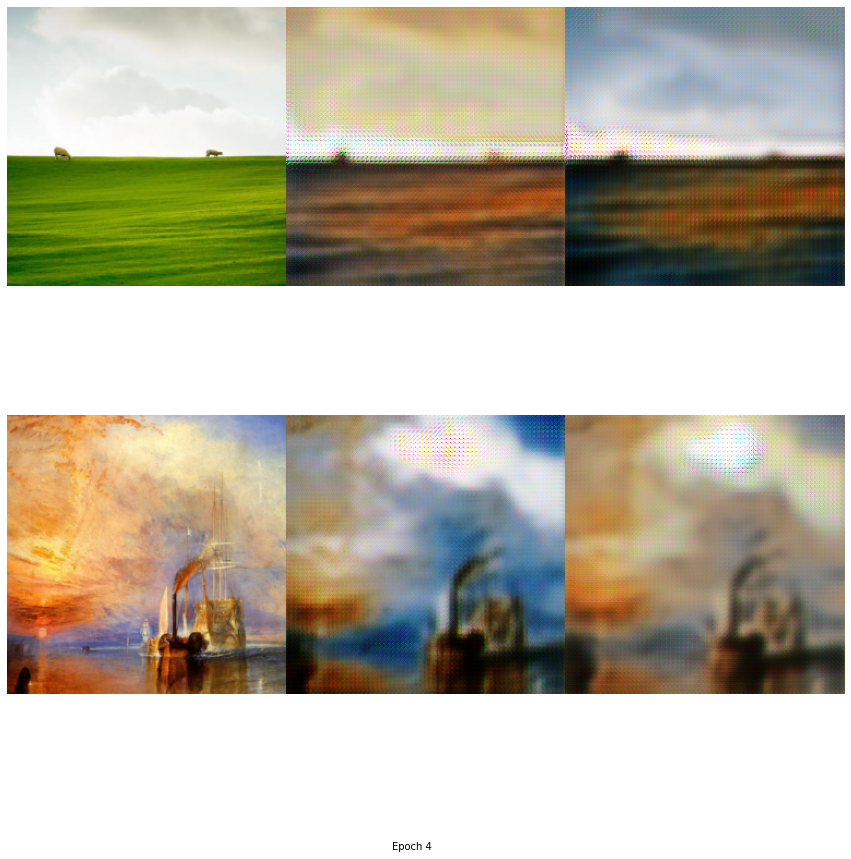

Epoch [5/20], Step [1/61], D_A_loss: 0.1981, D_B_loss: 0.0180, G_A_loss: 0.0760, G_B_loss: 0.8239


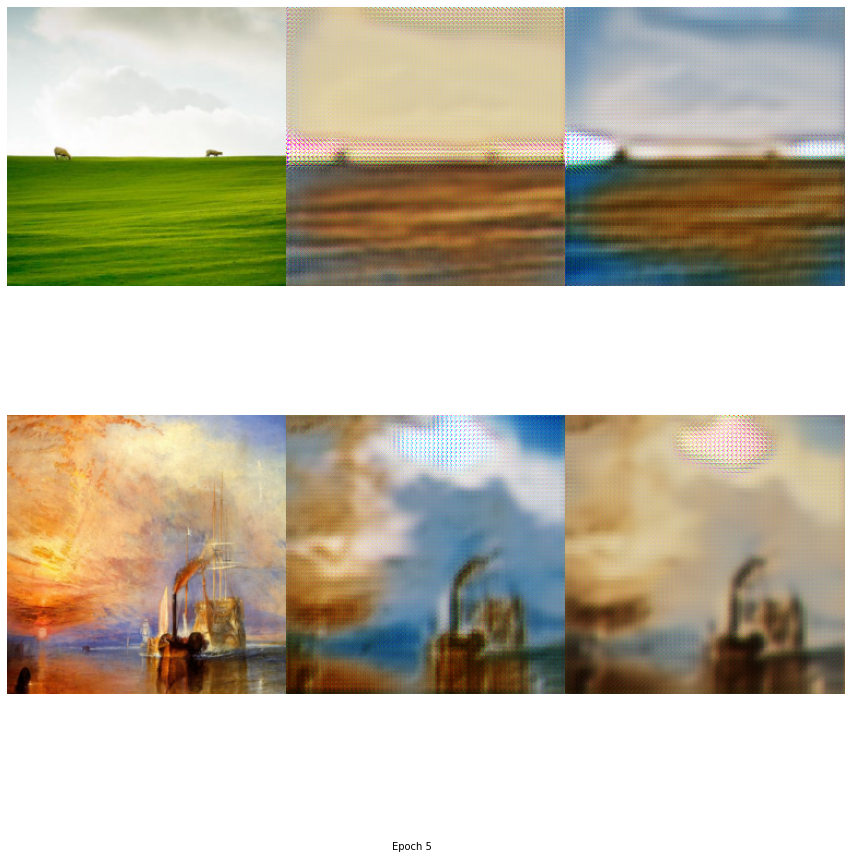

Epoch [6/20], Step [1/61], D_A_loss: 0.1039, D_B_loss: 0.3009, G_A_loss: 0.0618, G_B_loss: 0.2104


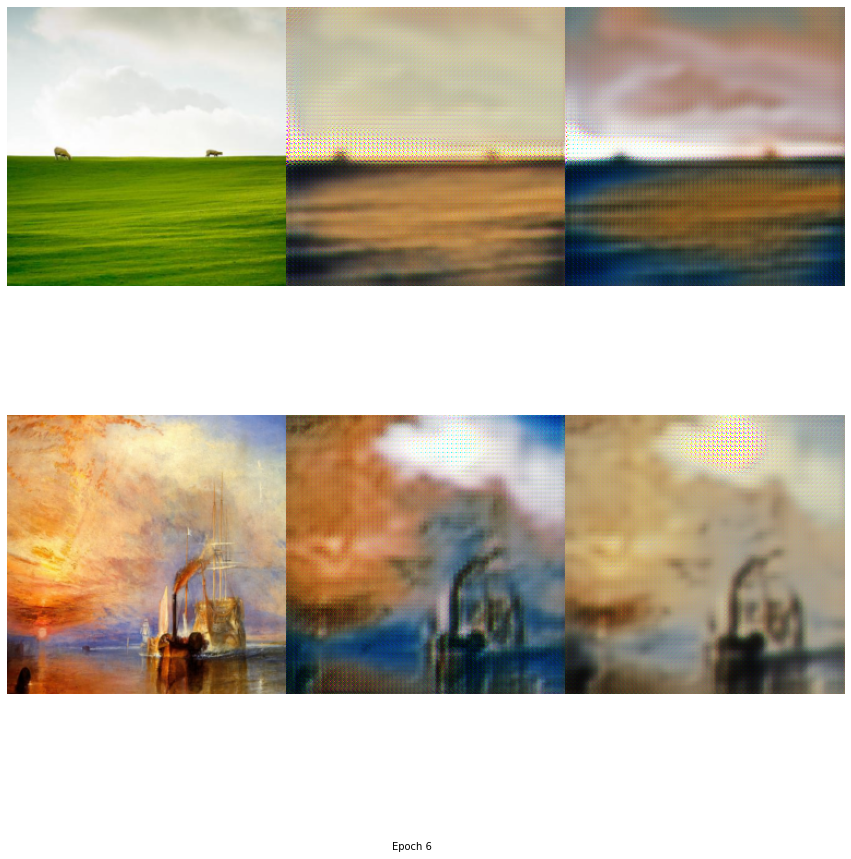

Epoch [7/20], Step [1/61], D_A_loss: 0.2724, D_B_loss: 0.2705, G_A_loss: 1.2255, G_B_loss: 0.0739


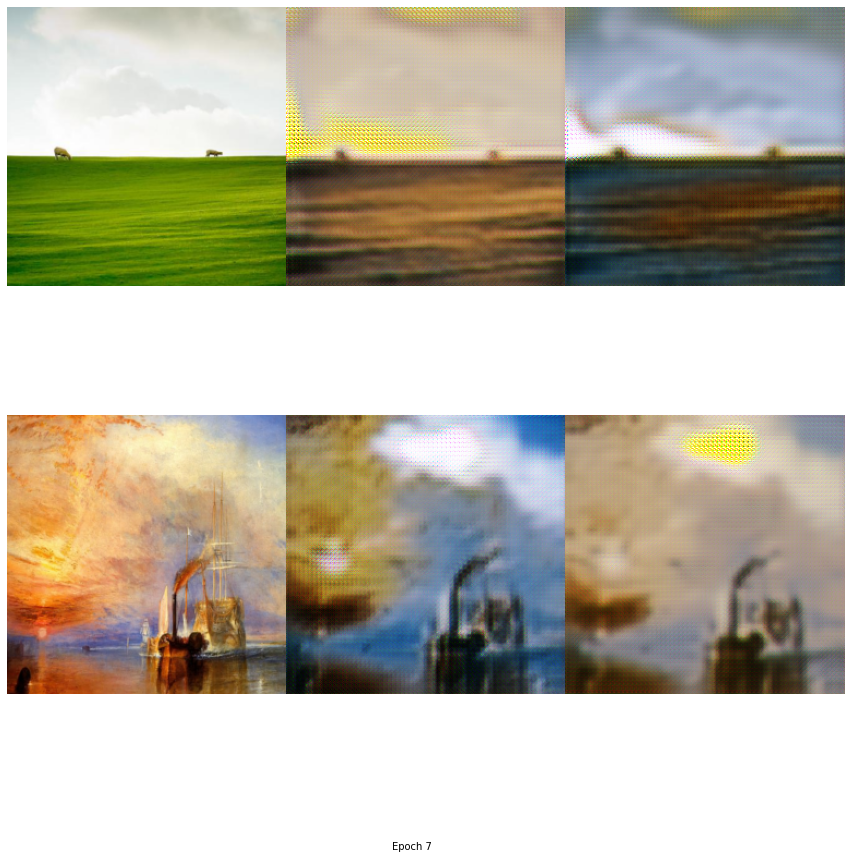

Epoch [8/20], Step [1/61], D_A_loss: 0.1067, D_B_loss: 0.0061, G_A_loss: 0.4439, G_B_loss: 0.4547


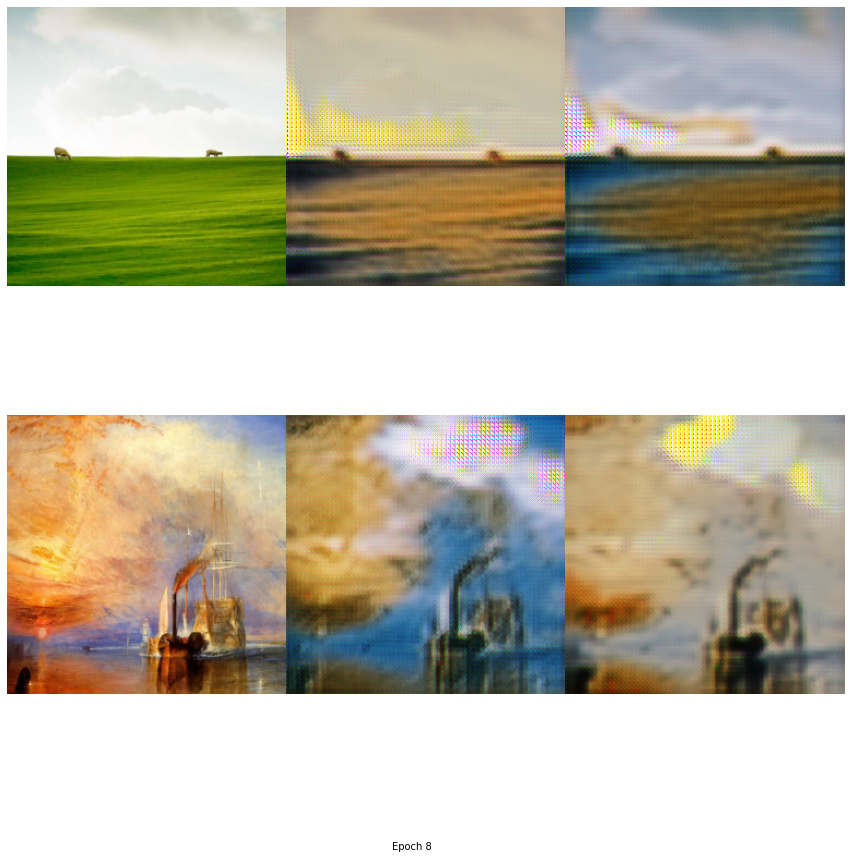

Epoch [9/20], Step [1/61], D_A_loss: 0.1486, D_B_loss: 0.0409, G_A_loss: 0.5812, G_B_loss: 0.3046


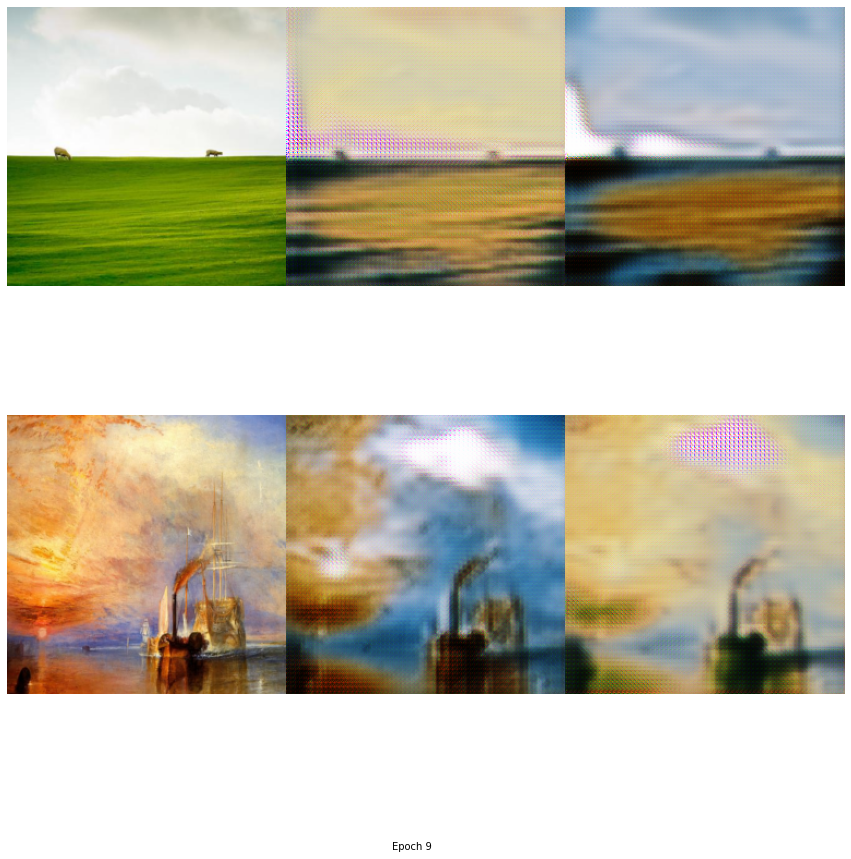

Epoch [10/20], Step [1/61], D_A_loss: 0.1461, D_B_loss: 0.0438, G_A_loss: 0.2492, G_B_loss: 1.0953


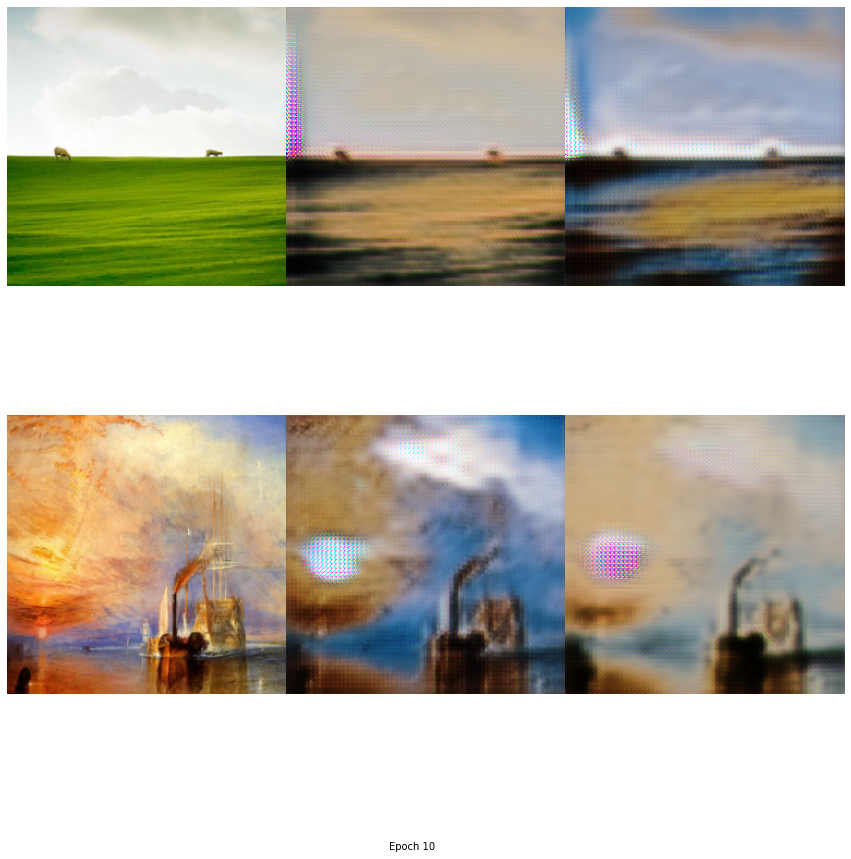

Epoch [11/20], Step [1/61], D_A_loss: 0.1504, D_B_loss: 0.0247, G_A_loss: 0.7174, G_B_loss: 0.5330


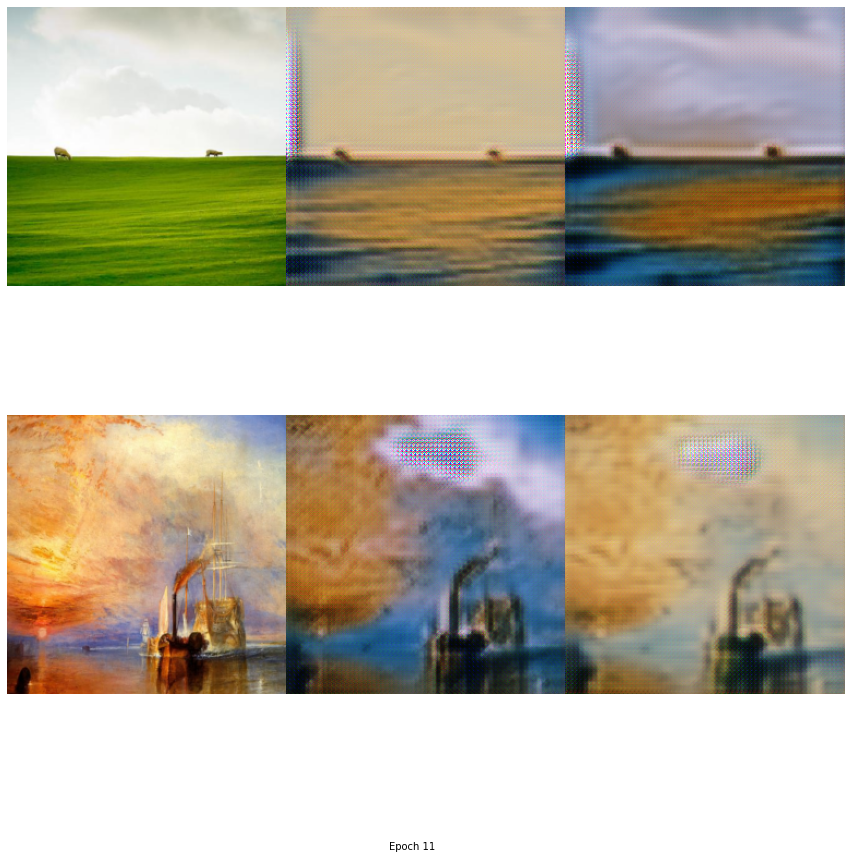

Epoch [12/20], Step [1/61], D_A_loss: 0.2635, D_B_loss: 0.2660, G_A_loss: 1.0468, G_B_loss: 0.0021


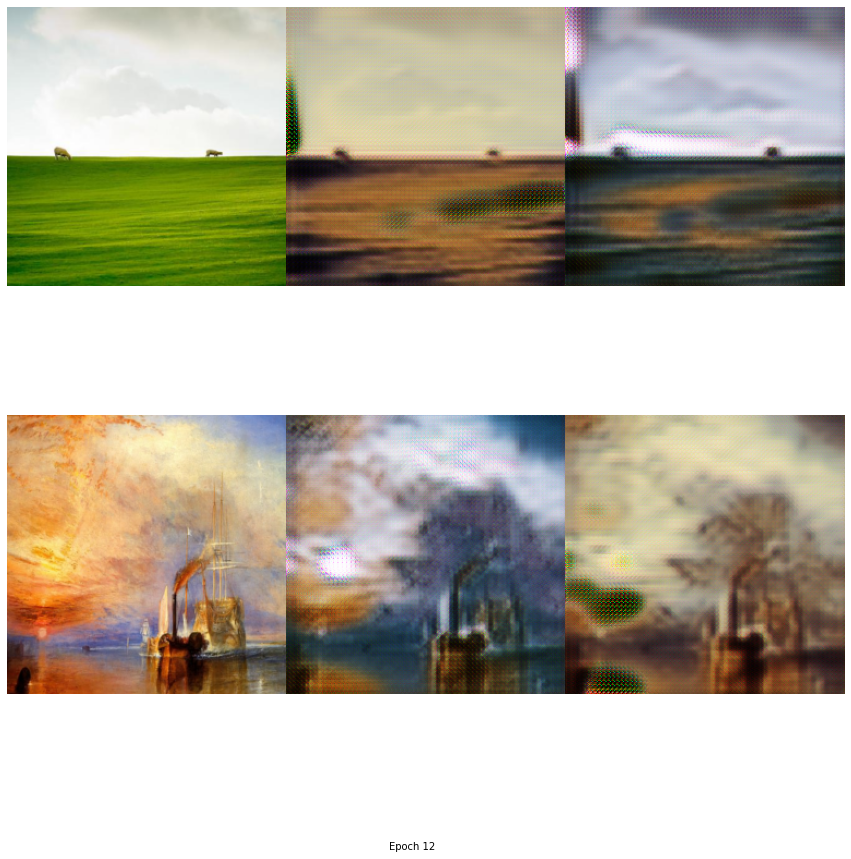

Epoch [13/20], Step [1/61], D_A_loss: 0.2236, D_B_loss: 0.1493, G_A_loss: 0.3880, G_B_loss: 0.1279


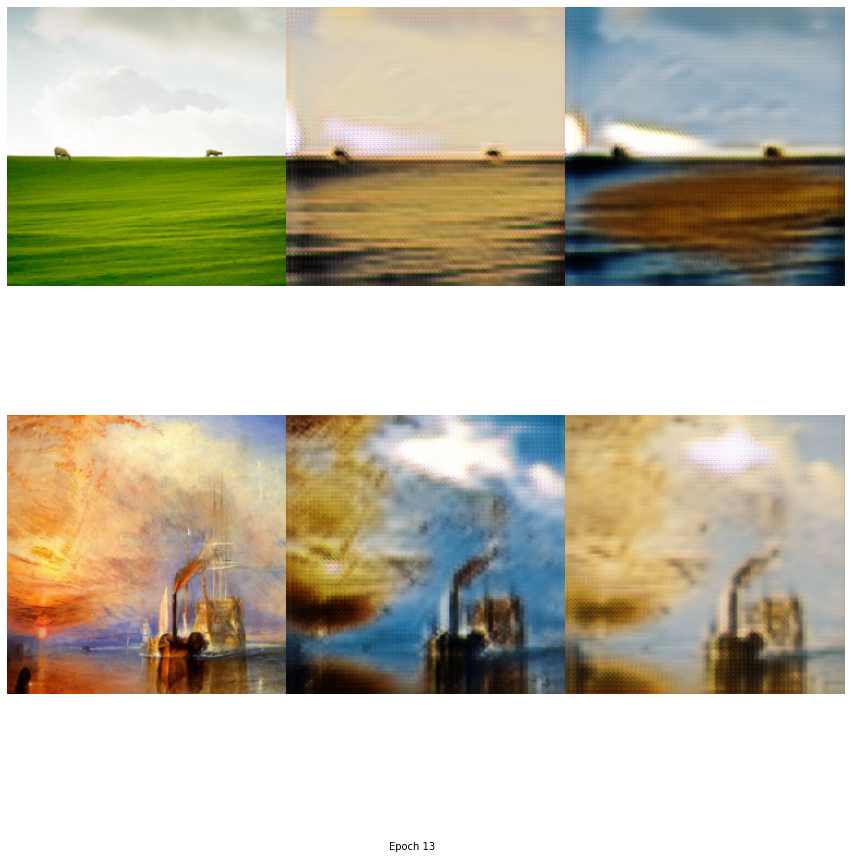

Epoch [14/20], Step [1/61], D_A_loss: 0.0038, D_B_loss: 0.1216, G_A_loss: 0.4887, G_B_loss: 0.7431


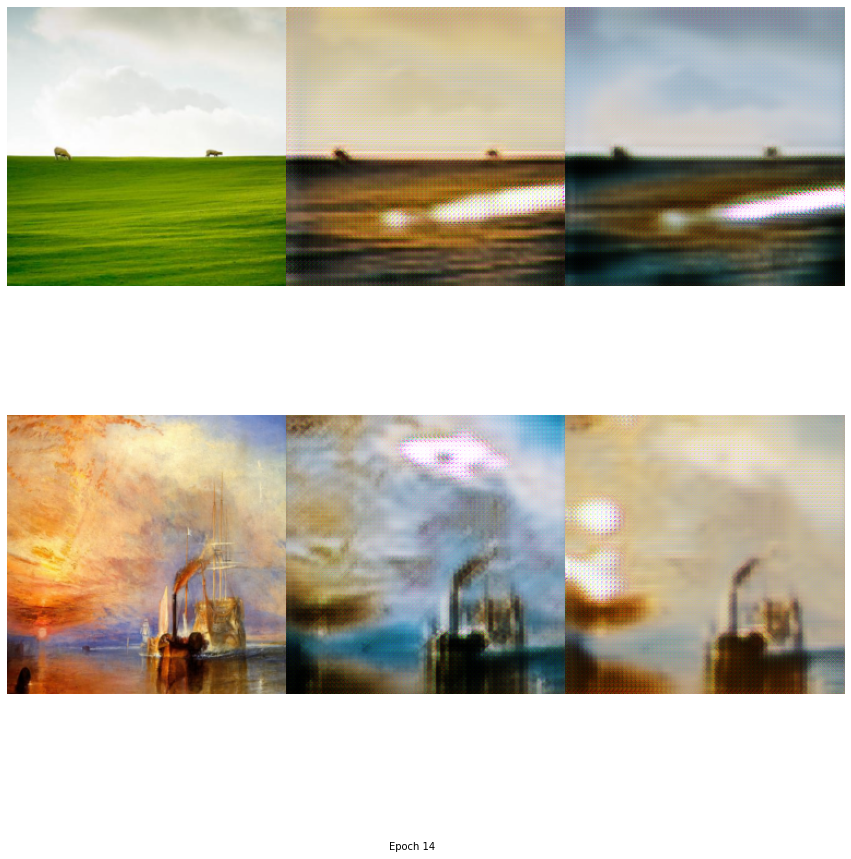

Epoch [15/20], Step [1/61], D_A_loss: 0.0366, D_B_loss: 0.1675, G_A_loss: 0.4073, G_B_loss: 0.1518


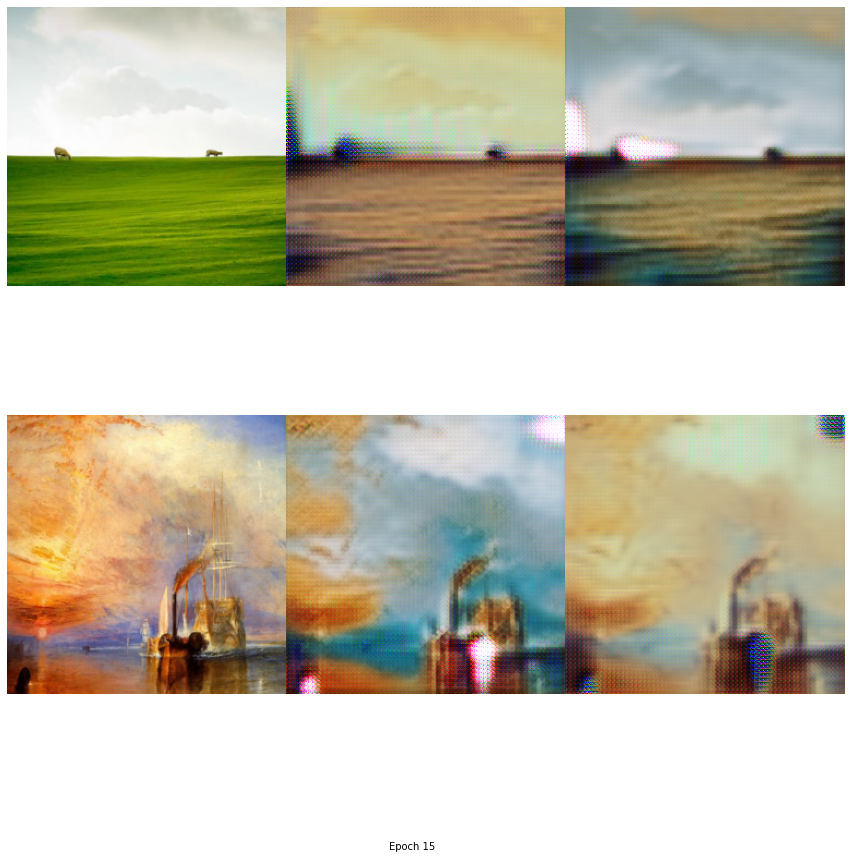

Epoch [16/20], Step [1/61], D_A_loss: 0.1268, D_B_loss: 0.1256, G_A_loss: 1.3877, G_B_loss: 0.5521


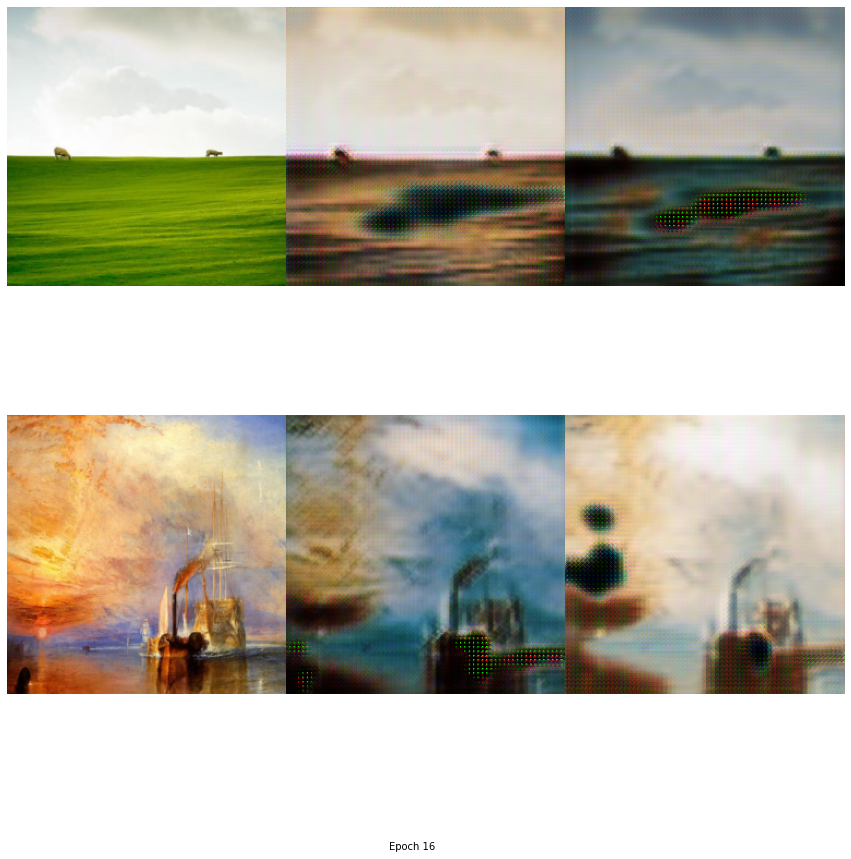

Epoch [17/20], Step [1/61], D_A_loss: 0.2638, D_B_loss: 0.2177, G_A_loss: 0.1074, G_B_loss: 0.4277


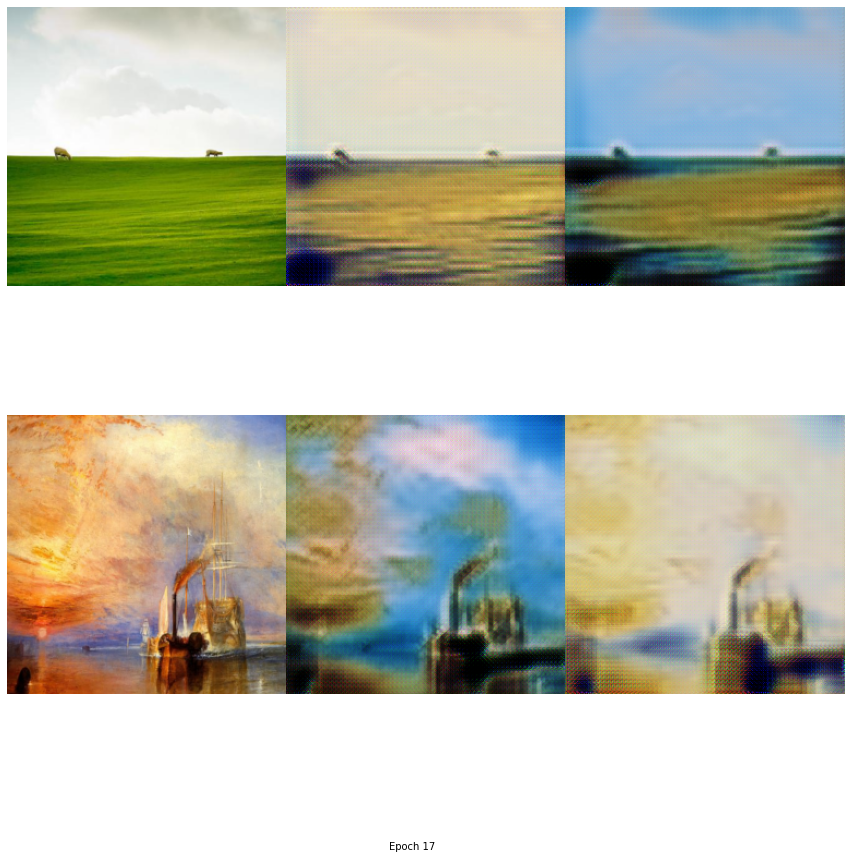

Epoch [18/20], Step [1/61], D_A_loss: 0.1790, D_B_loss: 0.2029, G_A_loss: 0.4642, G_B_loss: 0.1911


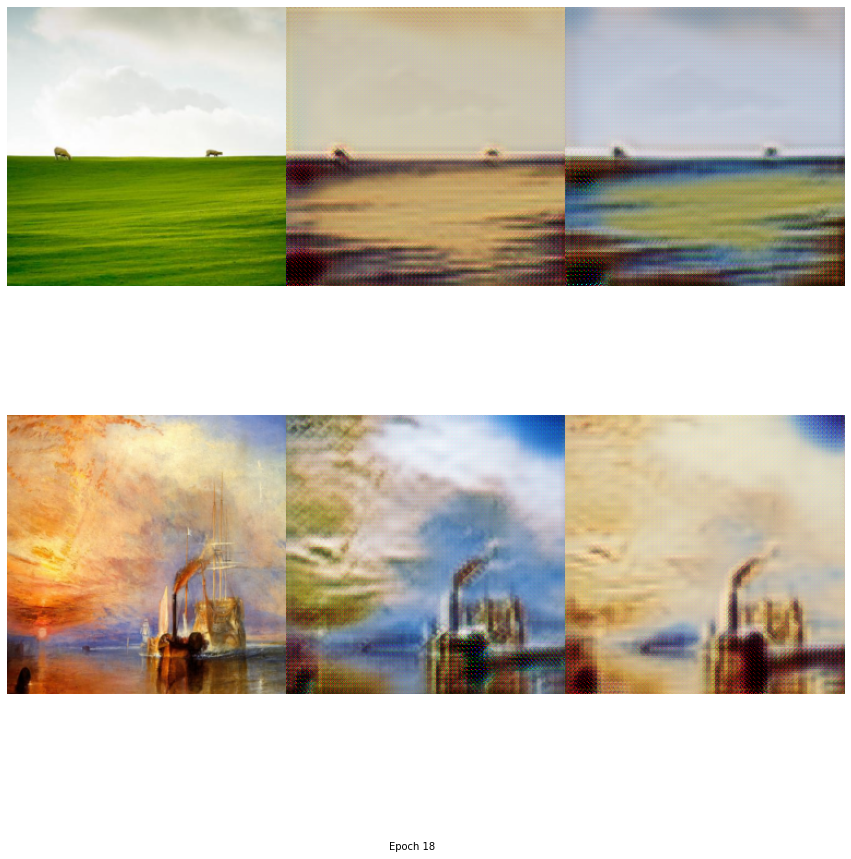

Epoch [19/20], Step [1/61], D_A_loss: 0.0258, D_B_loss: 0.0386, G_A_loss: 0.4887, G_B_loss: 0.1324


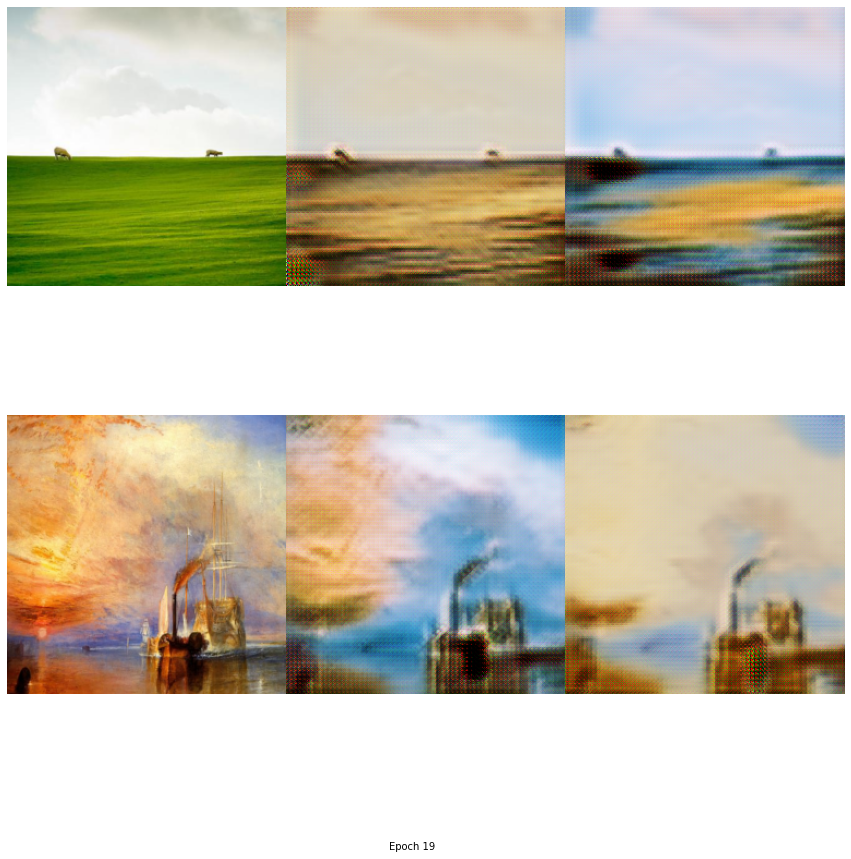

Epoch [20/20], Step [1/61], D_A_loss: 0.2500, D_B_loss: 0.1148, G_A_loss: 0.7537, G_B_loss: 0.1217


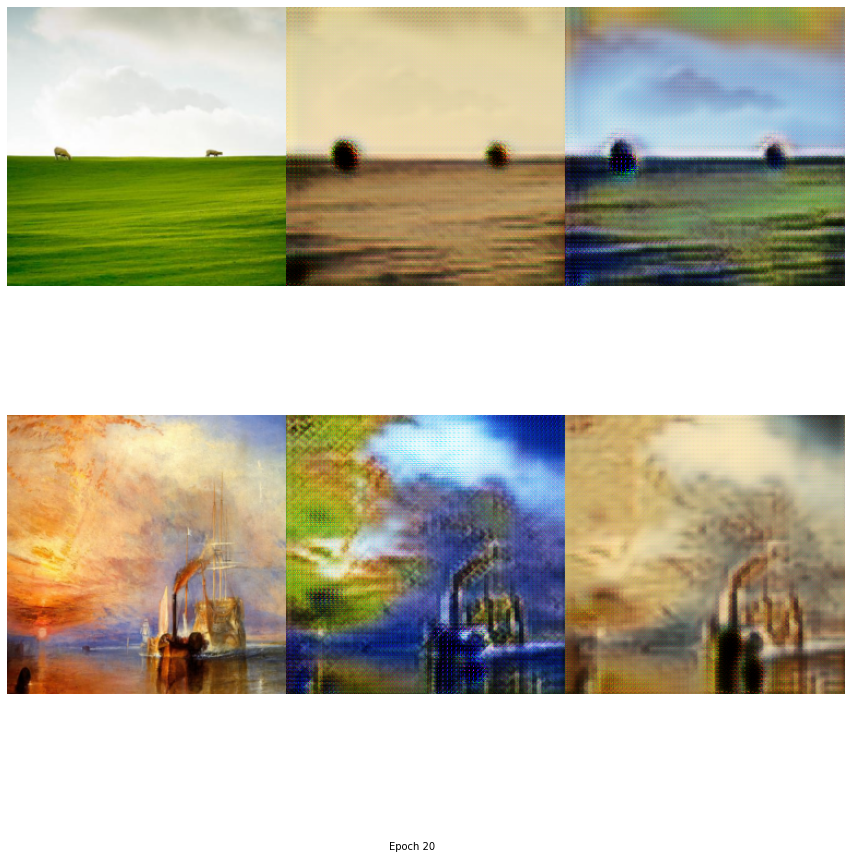

In [ ]:
D_A_avg_losses = []
D_B_avg_losses = []
G_A_avg_losses = []
G_B_avg_losses = []
cycle_A_avg_losses = []
cycle_B_avg_losses = []
STYLE_WEIGHT = 1e4

num_pool = 50
fake_A_pool = ImagePool(num_pool)
fake_B_pool = ImagePool(num_pool)

step = 0
for epoch in range(params['num_epochs']):
    D_A_losses = []
    D_B_losses = []
    G_A_losses = []
    G_B_losses = []
    cycle_A_losses = []
    cycle_B_losses = []
    
    # Learing rate decay 
    if(epoch + 1) > params['decay_epoch']:
        D_A_optimizer.param_groups[0]['lr'] -= params['lrD'] / (params['num_epochs'] - params['decay_epoch'])
        D_B_optimizer.param_groups[0]['lr'] -= params['lrD'] / (params['num_epochs'] - params['decay_epoch'])
        G_optimizer.param_groups[0]['lr'] -= params['lrG'] / (params['num_epochs'] - params['decay_epoch'])
        

        
    # training 
    for i, (real_A, real_B) in enumerate(zip(train_data_loader_A, train_data_loader_B)):
        
        # input image data
        real_A = real_A.to(device)
        real_B = real_B.to(device)
        
        # -------------------------- train generator G --------------------------
        # A --> B
        fake_B = G_A(real_A)
        a_idt = G_A(real_A)
        
        D_B_fake_decision = D_B(fake_B)
        G_A_loss = MSE_Loss(D_B_fake_decision, Variable(torch.ones(D_B_fake_decision.size()).cuda()))
        
        # forward cycle loss
        recon_A = G_B(fake_B)
        cycle_A_loss = L1_Loss(recon_A, real_A) * params['lambdaA']
        
        #idtA_loss = L1_Loss(a_idt,real_A) * 10*0.5 
        
        styleA_loss = compStyle(real_A,a_idt) 
        
    
        #G_B_loss = G_B_loss + (style_loss)/2
       
        #ends here
        
        # B --> A
        fake_A = G_B(real_B)
        b_idt = G_B(real_B)
        
        D_A_fake_decision = D_A(fake_A)
        G_B_loss = MSE_Loss(D_A_fake_decision, Variable(torch.ones(D_A_fake_decision.size()).cuda()))
        
        # backward cycle loss
        recon_B = G_A(fake_A)
        cycle_B_loss = L1_Loss(recon_B, real_B) * params['lambdaB']
        
        #idtB_loss = L1_Loss(b_idt,real_B) * 10*0.5 
    
        styleB_loss = compStyle(real_B,b_idt) 

        style_loss = (styleB_loss + styleA_loss)
        
        # Back propagation
        G_loss = G_A_loss + G_B_loss + cycle_A_loss + cycle_B_loss 
        
        G_loss = G_loss+style_loss * 2.5
        
        
        G_optimizer.zero_grad()
        G_loss.backward()
        G_optimizer.step()
    
        
        # -------------------------- train discriminator D_A --------------------------
        D_A_real_decision = D_A(real_A)
        D_A_real_loss = MSE_Loss(D_A_real_decision, Variable(torch.ones(D_A_real_decision.size()).cuda()))
        
        fake_A = fake_A_pool.query(fake_A)
        
        D_A_fake_decision = D_A(fake_A)
        D_A_fake_loss = MSE_Loss(D_A_fake_decision, Variable(torch.zeros(D_A_fake_decision.size()).cuda()))
        
       # D_A_recon_decision = D_A(recon_A)
        #D_A_recon_loss = MSE_Loss(D_A_recon_decision, Variable(torch.zeros(D_A_recon_decision.size()).cuda()))
        
        # Back propagation
        D_A_loss = (D_A_real_loss + D_A_fake_loss ) * 0.5
        D_A_optimizer.zero_grad()
        D_A_loss.backward()
        D_A_optimizer.step()
        
        
        # -------------------------- train discriminator D_B --------------------------
        D_B_real_decision = D_B(real_B)
        D_B_real_loss = MSE_Loss(D_B_real_decision, Variable(torch.ones(D_B_fake_decision.size()).cuda()))
        
        fake_B = fake_B_pool.query(fake_B)
        
        D_B_fake_decision = D_B(fake_B)
        D_B_fake_loss = MSE_Loss(D_B_fake_decision, Variable(torch.zeros(D_B_fake_decision.size()).cuda()))
        
        #D_B_recon_decision = D_B(recon_B)
        #D_B_recon_loss = MSE_Loss(D_B_recon_decision, Variable(torch.zeros(D_B_recon_decision.size()).cuda()))
        
        # Back propagation
        D_B_loss = (D_B_real_loss + D_B_fake_loss ) * 0.5
        D_B_optimizer.zero_grad()
        D_B_loss.backward()
        D_B_optimizer.step()
        
        # ------------------------ Print -----------------------------
        # loss values
        D_A_losses.append(D_A_loss.item())
        D_B_losses.append(D_B_loss.item())
        G_A_losses.append(G_A_loss.item())
        G_B_losses.append(G_B_loss.item())
        cycle_A_losses.append(cycle_A_loss.item())
        cycle_B_losses.append(cycle_B_loss.item())

        if i%100 == 0:
            print('Epoch [%d/%d], Step [%d/%d], D_A_loss: %.4f, D_B_loss: %.4f, G_A_loss: %.4f, G_B_loss: %.4f'
                  % (epoch+1, params['num_epochs'], i+1, len(train_data_loader_A), D_A_loss.item(), D_B_loss.item(), G_A_loss.item(), G_B_loss.item()))
            
        step += 1
        
    D_A_avg_loss = torch.mean(torch.FloatTensor(D_A_losses))
    D_B_avg_loss = torch.mean(torch.FloatTensor(D_B_losses))
    G_A_avg_loss = torch.mean(torch.FloatTensor(G_A_losses))
    G_B_avg_loss = torch.mean(torch.FloatTensor(G_B_losses))
    cycle_A_avg_loss = torch.mean(torch.FloatTensor(cycle_A_losses))
    cycle_B_avg_loss = torch.mean(torch.FloatTensor(cycle_B_losses))

    # avg loss values for plot
    D_A_avg_losses.append(D_A_avg_loss.item())
    D_B_avg_losses.append(D_B_avg_loss.item())
    G_A_avg_losses.append(G_A_avg_loss.item())
    G_B_avg_losses.append(G_B_avg_loss.item())
    cycle_A_avg_losses.append(cycle_A_avg_loss.item())
    cycle_B_avg_losses.append(cycle_B_avg_loss.item())
    
    # Show result for test image
    test_real_A = test_real_A_data.cuda()
    test_fake_B = G_A(test_real_A)
    test_recon_A = G_B(test_fake_B)

    test_real_B = test_real_B_data.cuda()
    test_fake_A = G_B(test_real_B)
    test_recon_B = G_A(test_fake_A)

    plot_train_result([test_real_A, test_real_B], [test_fake_B, test_fake_A], [test_recon_A, test_recon_B],
                            epoch, save=False)


# Test Model

In [ ]:
test_data_A = train_data_A
test_data_loader_A = torch.utils.data.DataLoader(dataset=test_data_A, batch_size=params['batch_size'], shuffle=False)
test_data_B = train_data_B
test_data_loader_B = torch.utils.data.DataLoader(dataset=test_data_B, batch_size=params['batch_size'], shuffle=False)

In [ ]:
count = 0
for i, (real_A, real_B) in enumerate(zip(train_data_loader_A, train_data_loader_B)):
    if(count<50):
        real_A = real_A.to(device)
        real_B = real_B.to(device)

        fake_B = G_A(real_A)
        test_recon_A = G_B(fake_B)

        fake_A = G_B(real_B)
        test_recon_B = G_A(fake_A)

        plot_train_result([real_A, real_B], [fake_B, fake_A], [test_recon_A, test_recon_B],count, save = True)
        count = count+1
    else:
        break